In [1]:
import stbt

In [2]:
device = "/dev/video0"
v4l2_ctls = "brightness=128,contrast=128,saturation=128,white_balance_temperature_auto=0,white_balance_temperature=6500,gain=60,backlight_compensation=0,exposure_auto=1,exposure_absolute=152,focus_auto=0,focus_absolute=0,power_line_frequency=1"
stbt.init_run(
    "v4l2src device=%s extra-controls=\"ctrls, %s\" "
    "! video/x-h264,width=1920 ! h264parse" % (device, v4l2_ctls),
    'xvimagesink sync=false',
    "none")

In [3]:
def set_ctrl(var, val):
    import subprocess
    subprocess.check_call(
        ['v4l2-ctl', '-d', device, "-c", "%s=%s" % (var, val)])

def imshow(img):
    import cv2
    
    from IPython.core.display import Image, display
    if isinstance(img, str) or isinstance(img, unicode):
        display(Image(img))
    else:
        _, data = cv2.imencode('.png', img)
        display(Image(data=str(data.data), format='png'))


In [4]:
import time

exposures = {}

for x in [3, 4, 8, 16, 32, 64, 128, 256, 512, 1024, 2047]: #range(3, 2048):
    set_ctrl('exposure_absolute', x)
    for _ in range(10):
        stbt.get_frame()
    exposures[x * 0.0001] = stbt.get_frame()

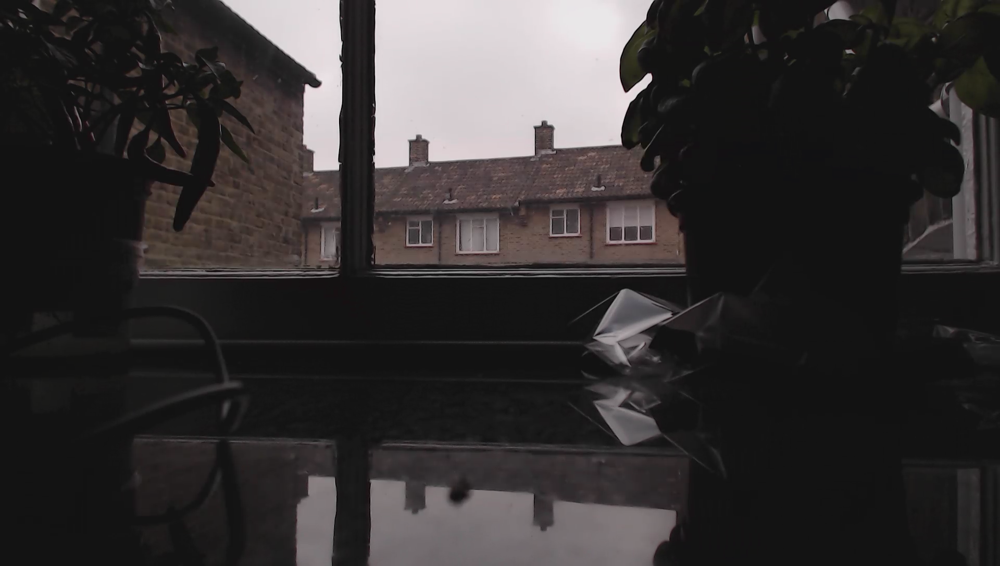

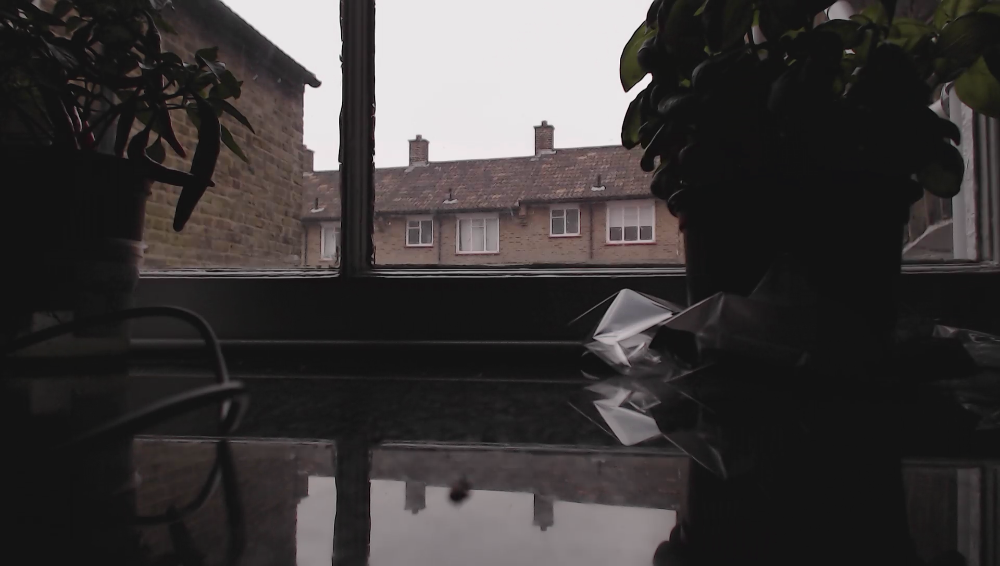

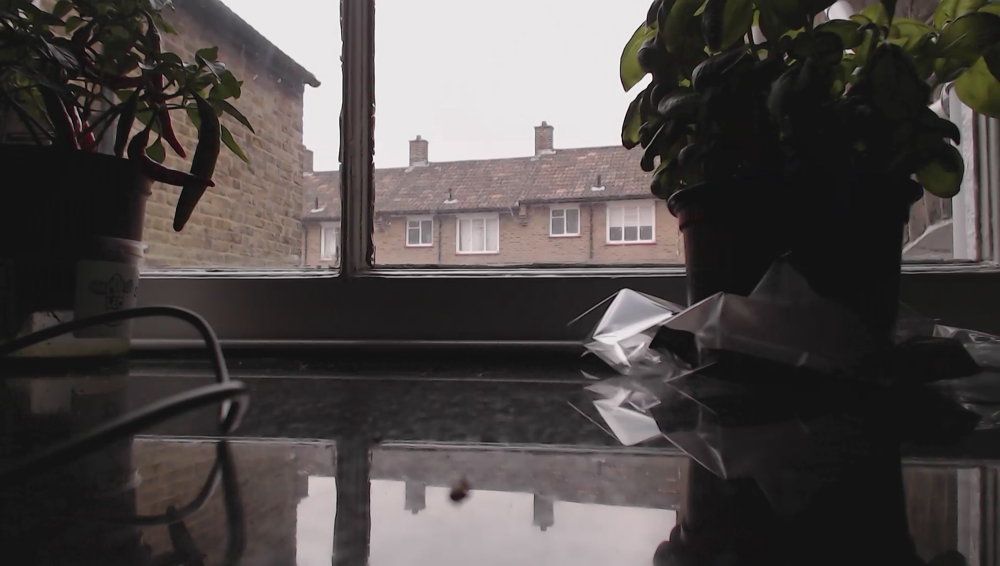

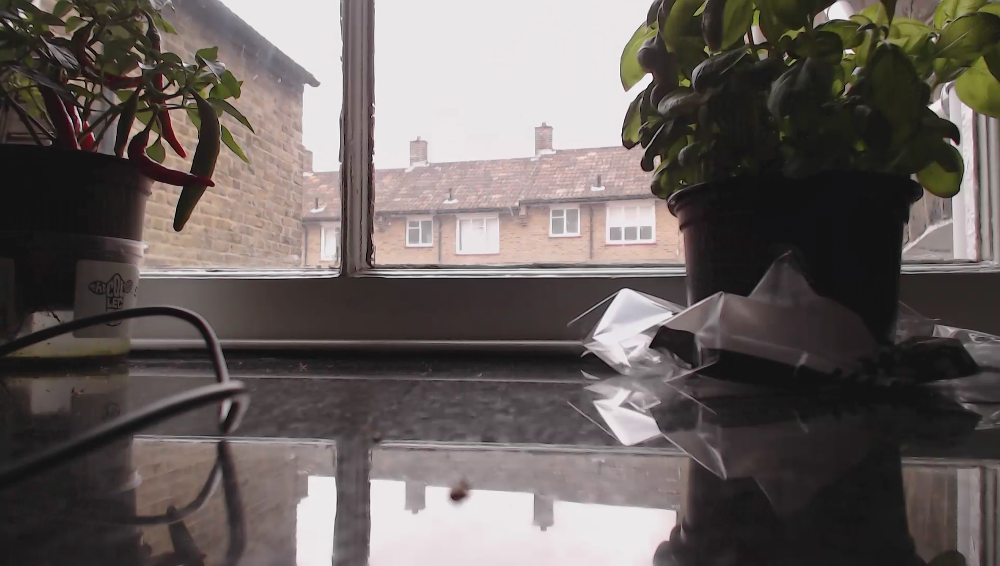

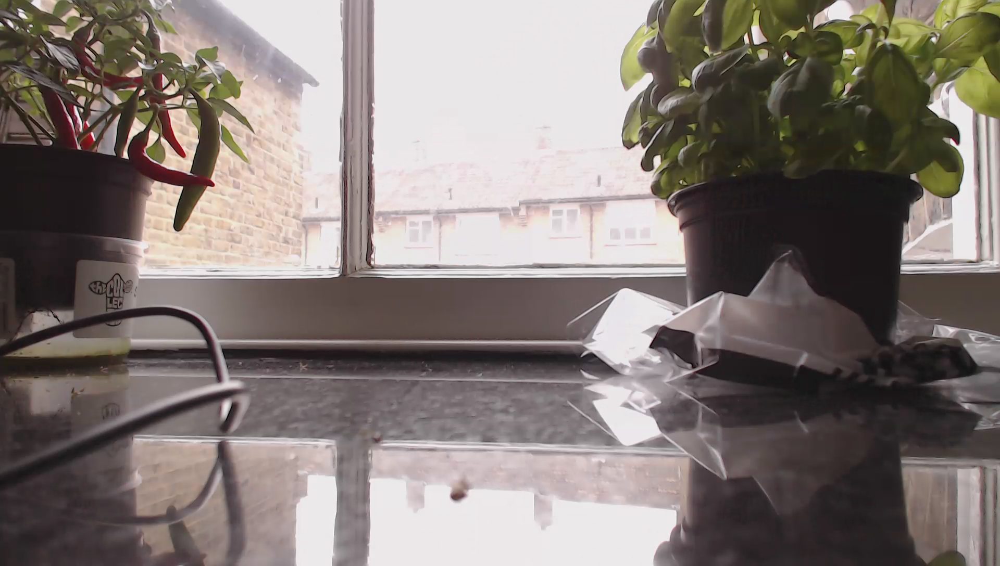

...

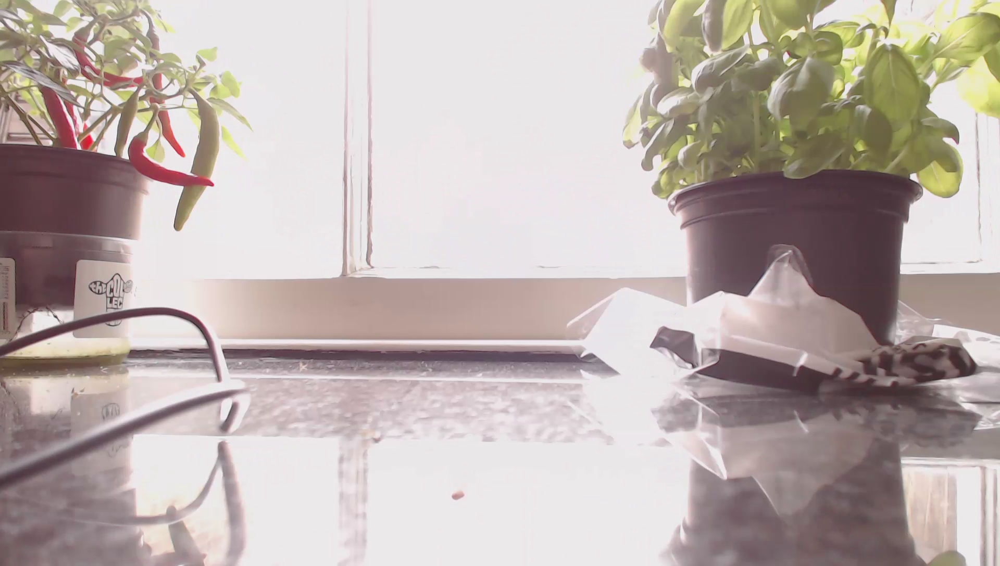

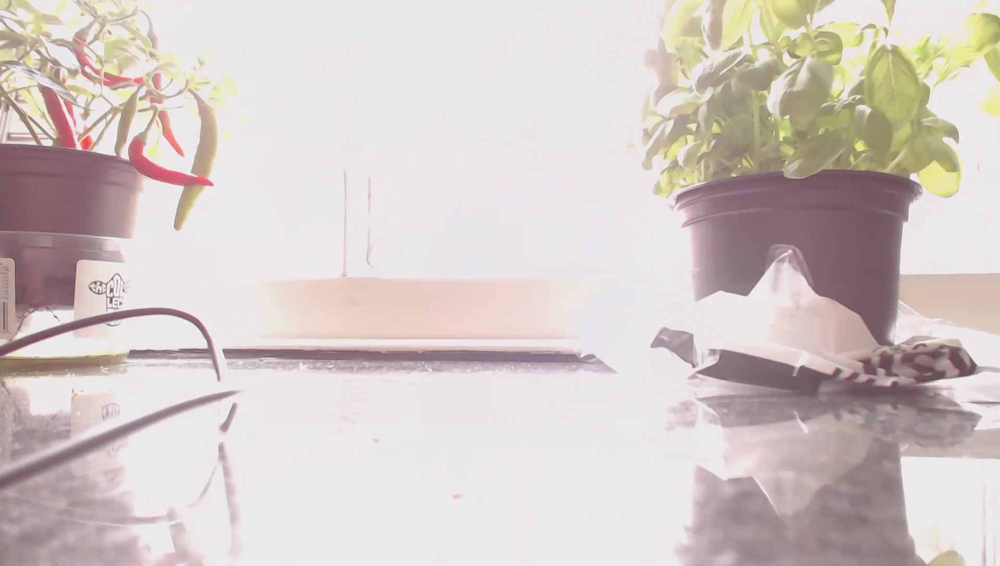

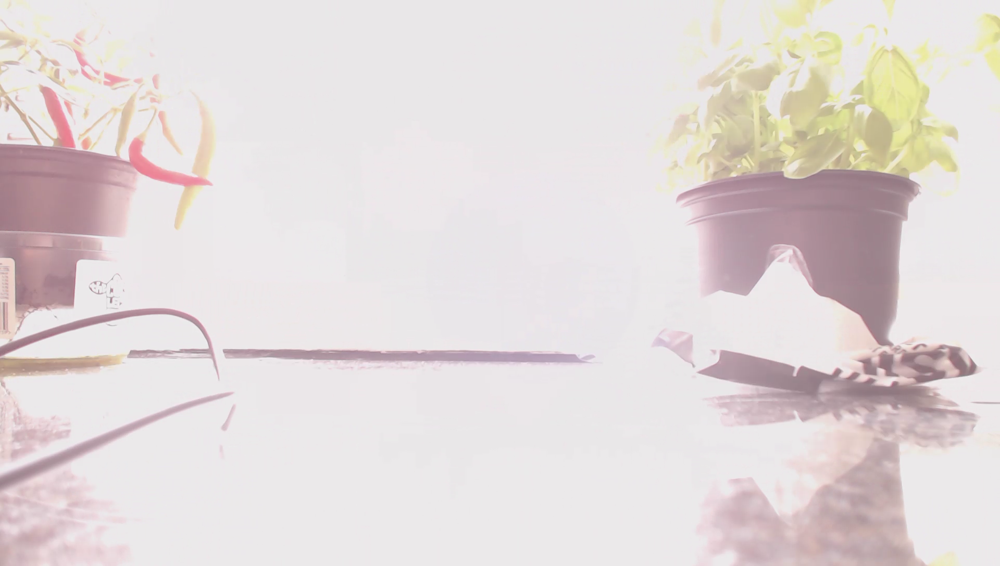

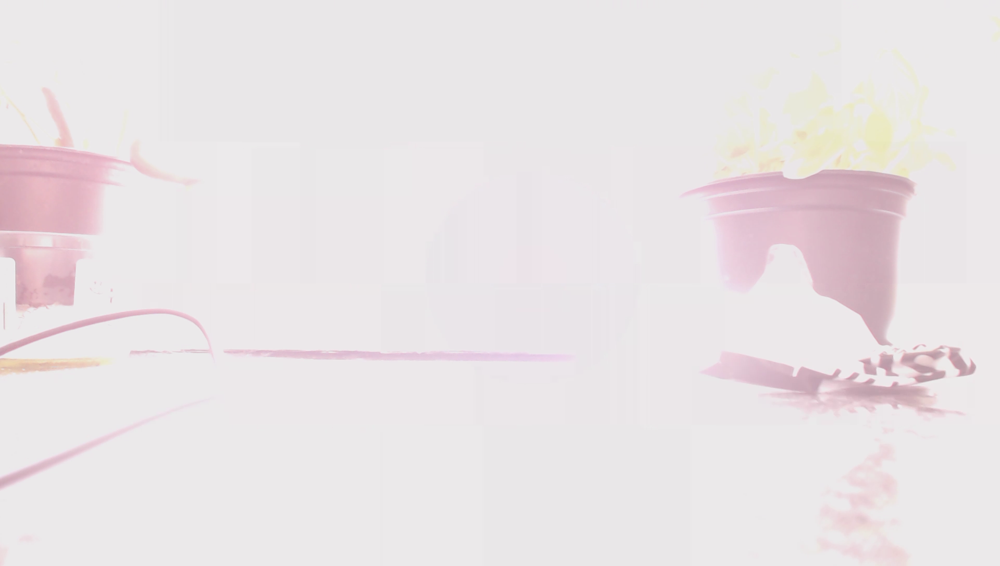

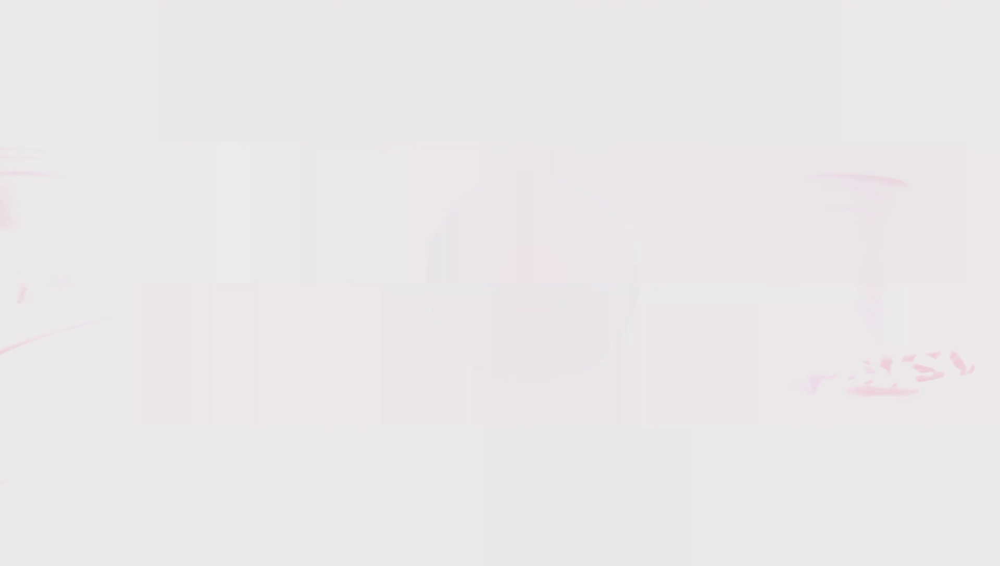

In [5]:
for x in sorted(exposures.items()):
    imshow(x[1])

$ Z_{i,j} = f(E_i\Delta t_j) $

$ g(Z_{i,j}) = \ln E_i + \ln \Delta t_j $

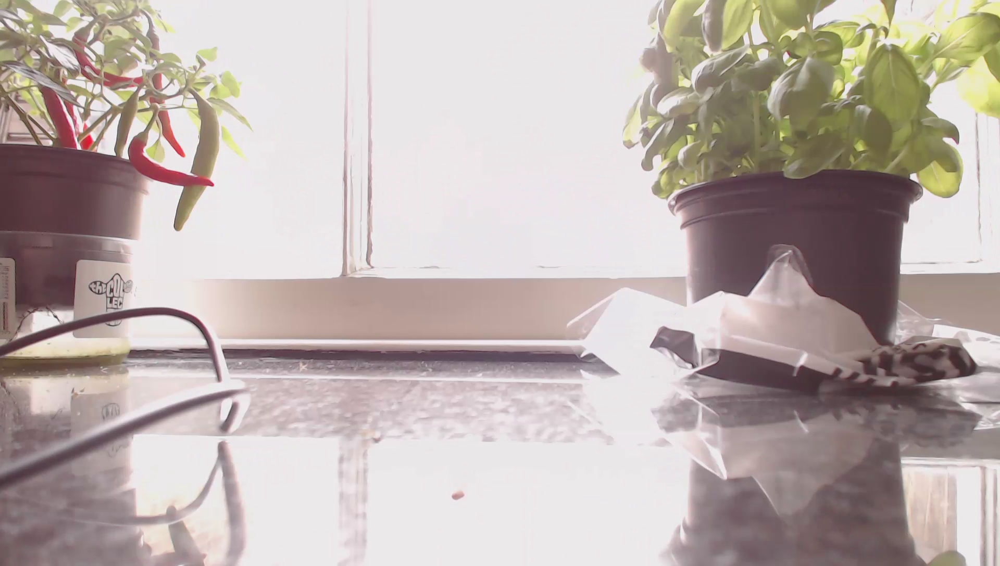

In [6]:
imshow(exposures.values()[1])


Bad key "backend_selection" on line 2 in
/home/william-manley/.config/matplotlib/matplotlibrc.
You probably need to get an updated matplotlibrc file from
http://matplotlib.sf.net/_static/matplotlibrc or from the matplotlib source
distribution


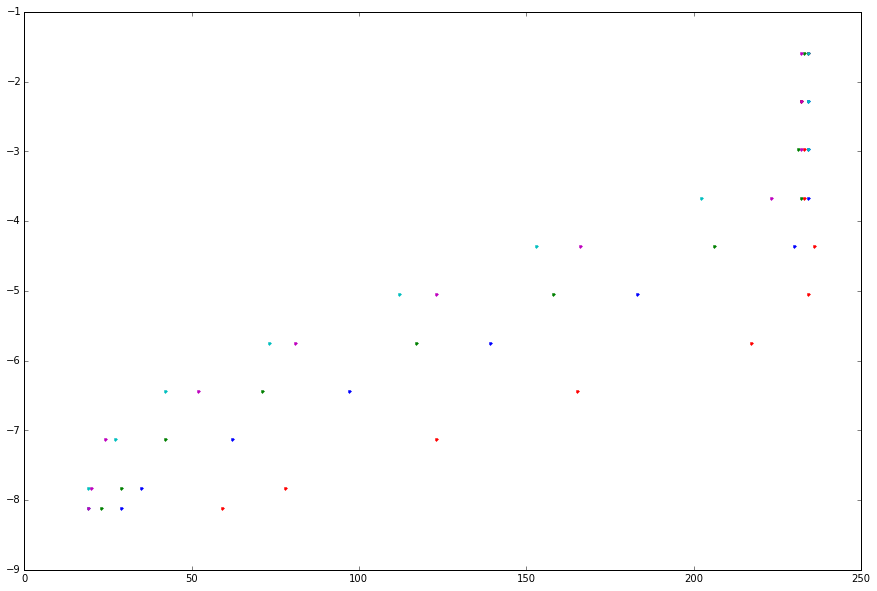

In [7]:
import cv2
import math
import pylab

%matplotlib inline
pylab.rcParams['figure.figsize'] = (15, 10)

pixel_locations = [
    (268, 987),
    (676, 432),
    (346, 366),
    (1897, 604),
    (1266, 42),
]

def get_pixel_vals():
    values = {}
    for t, image in sorted(exposures.items(), key=lambda x: x[0]):
        lt = math.log(t)
        values[lt] = {}
        grey = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        for px in pixel_locations:
            values[lt][px] = grey[px[1], px[0]]

    return values

values = get_pixel_vals()
for px in pixel_locations:
    pylab.plot(
        [x[px] for x in values.values()],
        values.keys(), '.')
pylab.show()

In [8]:
import scipy.optimize
import numpy

grey_exposures = {
    t: cv2.resize(
        cv2.cvtColor(image, cv2.COLOR_BGR2GRAY),
        dsize=(10, 10),
        interpolation=cv2.INTER_NEAREST).flatten()
    for t, image in exposures.items()}

lambda_ = 1

r1 = numpy.array(range(0, 254), dtype=numpy.uint8)
r2 = numpy.array(range(1, 255), dtype=numpy.uint8)
r3 = numpy.array(range(2, 256), dtype=numpy.uint8)

w = numpy.array(range(128) + range(128, 0, -1))

def fitness_fn(args):
    g = args[0:256]
    g[128] = 0.0
    E = args[256:]

    s = 0.0
    for t in grey_exposures.keys():
        rad = w[grey_exposures[t]] * g[grey_exposures[t]] - E - math.log(t)
        s += numpy.dot(rad, rad)

    # Smoothness term
    derivative = w[r2] * (g[r1] - 2 * g[r2] + g[r3])
    smoothness = numpy.dot(derivative, derivative)

    return s + lambda_ * smoothness

n = 256 + numpy.product(grey_exposures.values()[0].shape)

print grey_exposures.values()[0].shape

initial_guess = numpy.concatenate(
    (numpy.array(range(256), dtype=numpy.double),
     numpy.array(grey_exposures.values()[1])))
result = scipy.optimize.minimize(fitness_fn, initial_guess)

(100,)


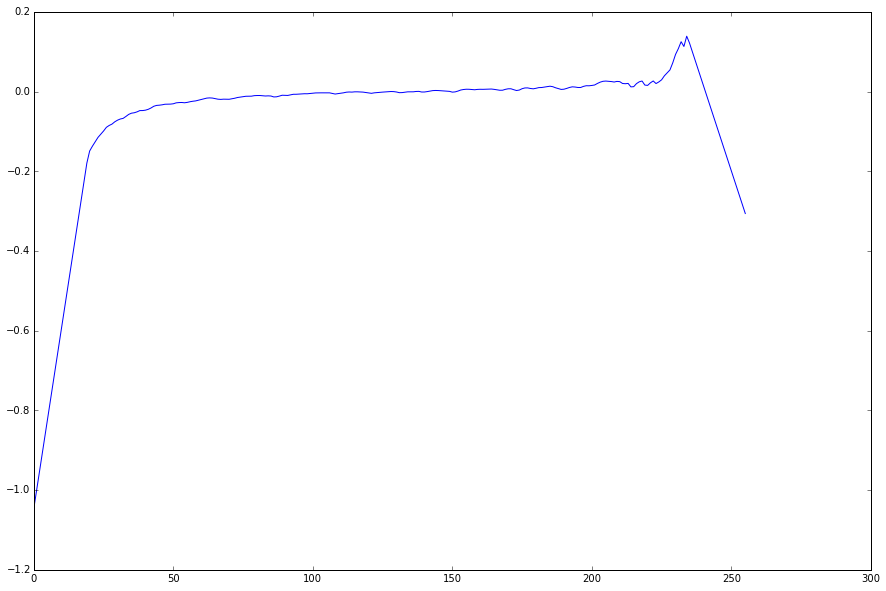

849.729594771


In [9]:
g = result.x[0:256]
g[128] = 0.0
E = result.x[256:]

E.shape = grey_exposures.values()[0].shape
pylab.plot(range(256), g)
pylab.show()
print fitness_fn(result.x)
#g

#E = E - numpy.min(E)
#E /= numpy.max(E) * 256
#imshow(E)

In [10]:
def to_hdr_image(g, exposures):
    out = numpy.zeros_like(exposures.values()[0], dtype=numpy.double)
    tweight = numpy.zeros_like(exposures.values()[0], dtype=numpy.double)
    for t, sdr in exposures.items():
        out += w[sdr] * (g[sdr] - math.log(t))
        tweight += w[sdr]
    out /= tweight
    return numpy.exp(out)

img = to_hdr_image(g, exposures)

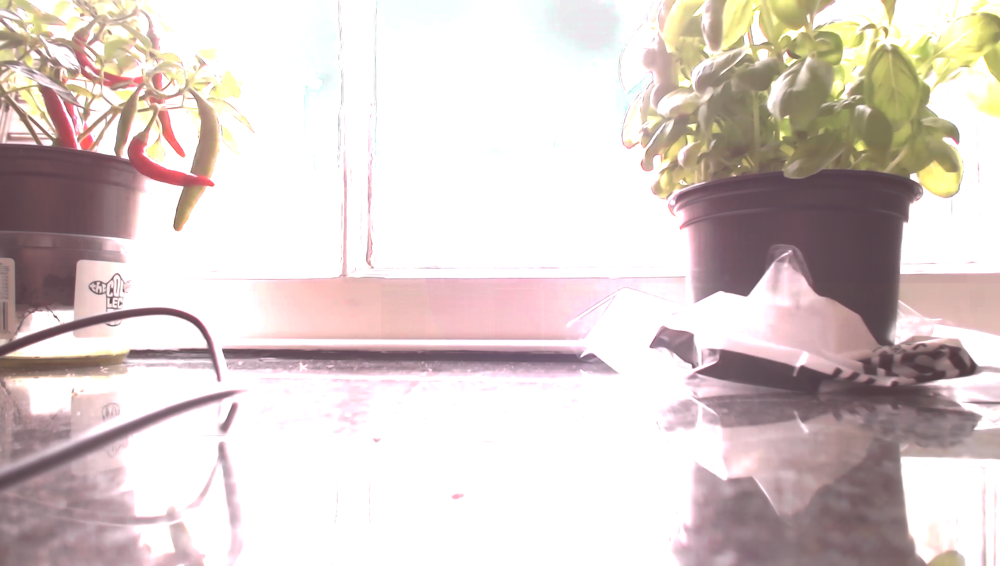

In [33]:
imshow(img*1.4)

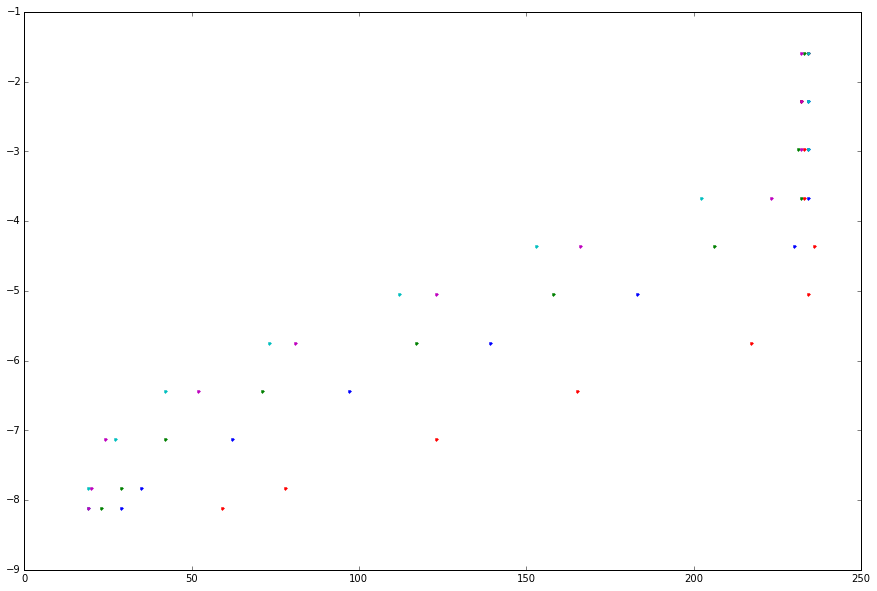

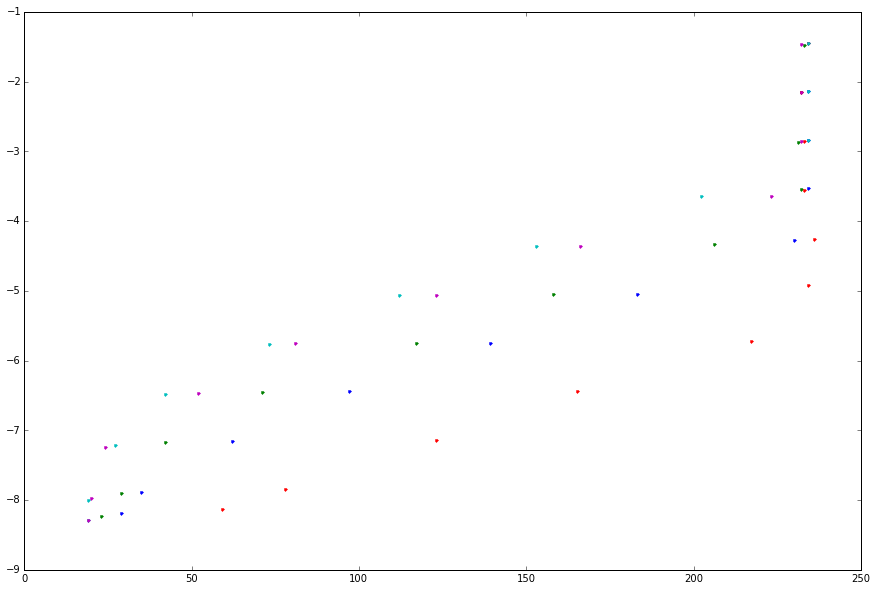

In [39]:
def get_pixel_vals():
    values = {}
    for t, image in sorted(exposures.items(), key=lambda x: x[0]):
        lt = math.log(t)
        values[lt] = {}
        grey = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        for px in pixel_locations:
            values[lt][px] = (
                grey[px[1], px[0]],
                math.log(t),
                g[grey[px[1], px[0]]] + math.log(t))

    return values

values = get_pixel_vals()

for px in pixel_locations:
    pylab.plot(
        [x[px][0] for x in values.values()],
        [x[px][1] for x in values.values()], '.')
pylab.show()

for px in pixel_locations:
    pylab.plot(
        [x[px][0] for x in values.values()],
        [x[px][2] for x in values.values()], '.')
pylab.show()
